In [3]:
import torch
import torch.nn               as nn
import torch.nn.parallel
import torch.optim            as optim
import torch.utils.data
import torchvision.datasets   as dset
import torchvision.transforms as transforms
import torchvision.utils      as vutils

import numpy                  as np
import matplotlib.pyplot      as plt
import matplotlib.animation   as animation

import model                  as m
from IPython.display          import HTML

In [21]:
# Hyperparameters
data_dir       = "../data/celeba"
workers        = 2
batch_size     = 128
img_size       = 64
img_channels   = 3
z_dim          = 100
g_hidden_dim   = 64
c_hidden_dim   = 64
epochs         = 40
lr             = 2e-4
betas          = (0.5, 0.999)
crit_repeats   = 5
c_lambda       = 10
display_step   = 500
device         = "cuda"

transform = transforms.Compose([
    transforms.Resize(img_size),
    transforms.CenterCrop(img_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5),
                         (0.5, 0.5, 0.5))
])

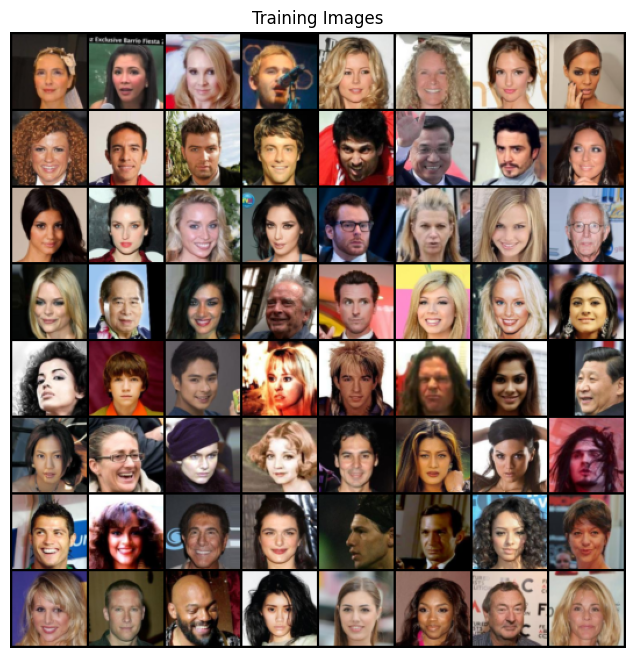

In [22]:
dataset = dset.ImageFolder(root=data_dir,
                           transform=transform)

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [23]:
gen  = m.Generator(z_dim, g_hidden_dim, img_channels).to(device)
crit = m.Critic(c_hidden_dim, img_channels).to(device)

gen.apply(m.weights_init)
crit.apply(m.weights_init)

Critic(
  (crit): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1))
  )
)

In [24]:
fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)

gen_optim  = optim.Adam(gen.parameters(),  lr=lr, betas=betas)
crit_optim = optim.Adam(crit.parameters(), lr=lr, betas=betas)

In [25]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    mixed_images = (real * epsilon + fake * (1 - epsilon))
    mixed_scores = crit(mixed_images)
    
    return torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True
    )[0]

In [26]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten gradient so each row is one image
    gradient = gradient.view(len(gradient), -1)

    # Get magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)

    return torch.mean((1 - gradient_norm) ** 2)

In [27]:
# Training loop
iters = 0
img_list = []
gen_losses = []
crit_losses = []

for epoch in range(epochs):
    for i, data in enumerate(dataloader, 0):
        real = data[0].to(device)
        cur_batch_size = real.size(0)

        # Train critic
        mean_iter_crit_loss = 0
        for _ in range(crit_repeats):
            crit.zero_grad()
            noise = torch.randn(cur_batch_size, z_dim, 1, 1, device=device)
            fake = gen(noise)
            crit_fake_pred = crit(fake.detach()).view(-1)
            crit_real_pred = crit(real).view(-1)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = torch.mean((crit_fake_pred - crit_real_pred) + (gp * c_lambda))

            mean_iter_crit_loss += crit_loss.item() / crit_repeats
            crit_loss.backward(retain_graph=True)
            crit_optim.step()
        
        crit_losses += [mean_iter_crit_loss]

        # Train generator
        gen.zero_grad()
        noise = torch.randn(cur_batch_size, z_dim, 1, 1, device=device)
        fake = gen(noise)
        crit_fake_pred = crit(fake)

        gen_loss = -torch.mean(crit_fake_pred)
        gen_loss.backward()
        gen_optim.step()

        gen_losses += [gen_loss.item()]

        if iters % display_step == 0 and iters > 0:
            gen_mean  = sum(gen_losses[-display_step:]) / display_step
            crit_mean = sum(crit_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, iter {iters}: Gen loss: {gen_mean}, Crit loss: {crit_mean}")

            with torch.no_grad():
                fake = gen(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


Epoch 0, iter 500: Gen loss: -47.76139425086975, Crit loss: -20.585319999504076
Epoch 0, iter 1000: Gen loss: -29.68936707305908, Crit loss: -10.827597186237579
Epoch 0, iter 1500: Gen loss: -29.451090623021127, Crit loss: -9.598999471396207
Epoch 1, iter 2000: Gen loss: -21.784760382413864, Crit loss: -5.295220338720082
Epoch 1, iter 2500: Gen loss: -22.133038155317305, Crit loss: -5.773938751578334
Epoch 1, iter 3000: Gen loss: -26.076196422576903, Crit loss: -5.112838721176977
Epoch 2, iter 3500: Gen loss: -25.24655909395218, Crit loss: -4.50024816542268
Epoch 2, iter 4000: Gen loss: -27.333002197265625, Crit loss: -4.134470627284051
Epoch 2, iter 4500: Gen loss: -25.862435515880584, Crit loss: -4.757500702428825
Epoch 3, iter 5000: Gen loss: -26.15763436794281, Crit loss: -4.596614646142726
Epoch 3, iter 5500: Gen loss: -20.2168421459198, Crit loss: -4.382626287293433
Epoch 3, iter 6000: Gen loss: -22.202412791132925, Crit loss: -3.6198427902281356
Epoch 4, iter 6500: Gen loss: -24

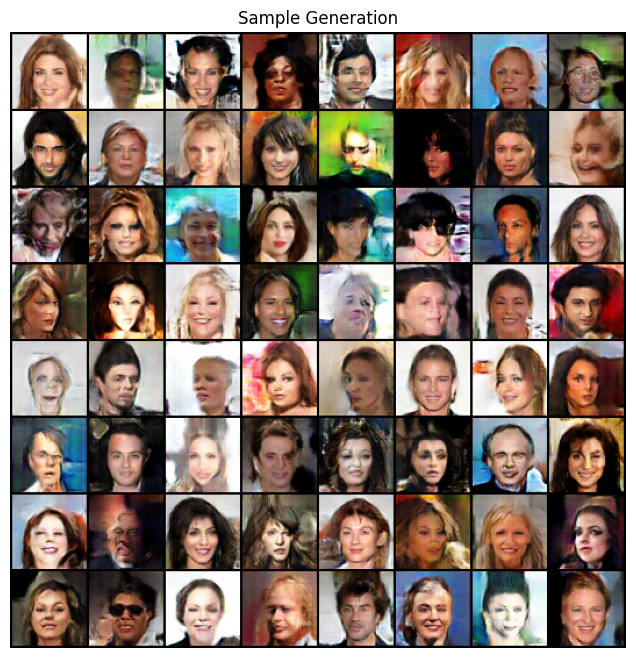

In [28]:
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Sample Generation")
plt.imshow(np.transpose(vutils.make_grid(fake.to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

Animation size has reached 21866318 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


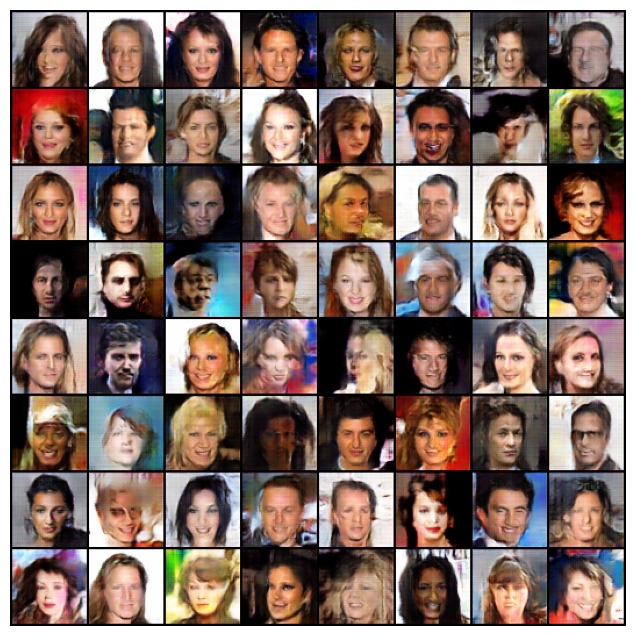

In [29]:
f = plt.figure(figsize=(8, 8))
plt.axis("off")

ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(f, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())